In [94]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import os
os.getcwd()
import plotly.express as px
from plotly.subplots import make_subplots

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

In [2]:
data = pd.read_csv('SpotifyDataset/data.csv')
data_artist = pd.read_csv('SpotifyDataset/data_by_artist.csv')
data_genres = pd.read_csv('SpotifyDataset/data_by_genres.csv')
data_years = pd.read_csv('SpotifyDataset/data_by_year.csv')
data_wgenres = pd.read_csv('SpotifyDataset/data_w_genres.csv')

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
data_artist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


In [5]:
data_genres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [6]:
data_years.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [7]:
data_wgenres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genres            28680 non-null  object 
 1   artists           28680 non-null  object 
 2   acousticness      28680 non-null  float64
 3   danceability      28680 non-null  float64
 4   duration_ms       28680 non-null  float64
 5   energy            28680 non-null  float64
 6   instrumentalness  28680 non-null  float64
 7   liveness          28680 non-null  float64
 8   loudness          28680 non-null  float64
 9   speechiness       28680 non-null  float64
 10  tempo             28680 non-null  float64
 11  valence           28680 non-null  float64
 12  popularity        28680 non-null  float64
 13  key               28680 non-null  int64  
 14  mode              28680 non-null  int64  
 15  count             28680 non-null  int64  
dtypes: float64(11), int64(3), object(2)
memo

In [8]:
data['decade'] = data['year'].apply(lambda year : f'{(year//10)*10}s' )
data['decade']

0         1920s
1         1920s
2         1920s
3         1920s
4         1920s
          ...  
170648    2020s
170649    2020s
170650    2020s
170651    2020s
170652    2020s
Name: decade, Length: 170653, dtype: object

<Axes: xlabel='count', ylabel='decade'>

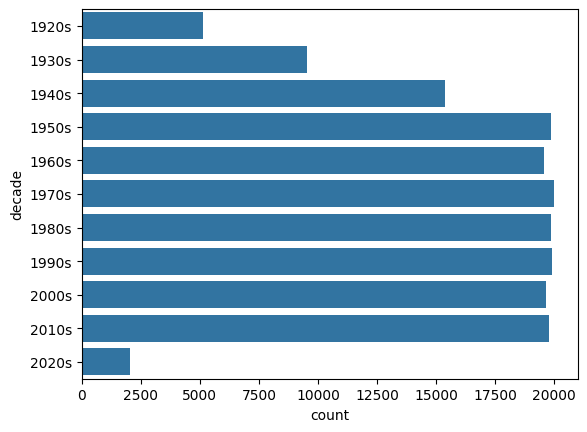

In [59]:
sns.countplot(data['decade'],)

In [37]:
object_columns = data.select_dtypes(include=['object']).columns.tolist()
object_columns.remove('decade')
object_columns.append('year')
dataNum = data.loc[:, ~data.columns.isin(object_columns)]
dataNum = dataNum.groupby(['decade']).mean()
# len(dataNum.columns)
dataNum

,valence,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
decade,,,,,,,,,,,,,,
1920s,0.542143,0.801554,0.586963,183769.229419,0.235133,0.133632,0.377181,5.405579,0.210910,-16.699090,0.694108,1.304331,0.291475,110.431253
1930s,0.567896,0.867694,0.541664,207616.599539,0.286655,0.061891,0.276707,5.310713,0.225639,-14.214586,0.693266,2.536601,0.204065,111.545690
1940s,0.487830,0.870974,0.473476,217894.653661,0.254896,0.071076,0.363176,5.178697,0.221343,-15.331419,0.702042,1.876252,0.153847,107.379639
1950s,0.478597,0.840334,0.476858,220482.874358,0.286753,0.007758,0.247795,5.030227,0.209219,-14.731226,0.710882,10.692091,0.093679,110.972049
1960s,0.551939,0.624013,0.494697,211668.431071,0.414520,0.000563,0.157578,5.107269,0.208687,-12.676736,0.753952,26.551742,0.057731,115.166468
1970s,0.585098,0.400162,0.524927,254051.705500,0.533716,0.003550,0.116031,5.088750,0.216406,-11.424966,0.743200,35.055800,0.059764,119.858574
1980s,0.564420,0.298634,0.546385,252120.366045,0.594715,0.023224,0.122269,5.270932,0.204639,-11.226990,0.709874,37.523426,0.062035,121.345255
1990s,0.544997,0.307533,0.566082,248595.562535,0.586066,0.115120,0.109744,5.330235,0.196547,-10.004415,0.723079,44.192252,0.080528,119.404234
2000s,0.530295,0.269761,0.574142,239517.406953,0.651586,0.141301,0.083848,5.282297,0.195582,-7.501916,0.685483,49.734348,0.087719,121.254695


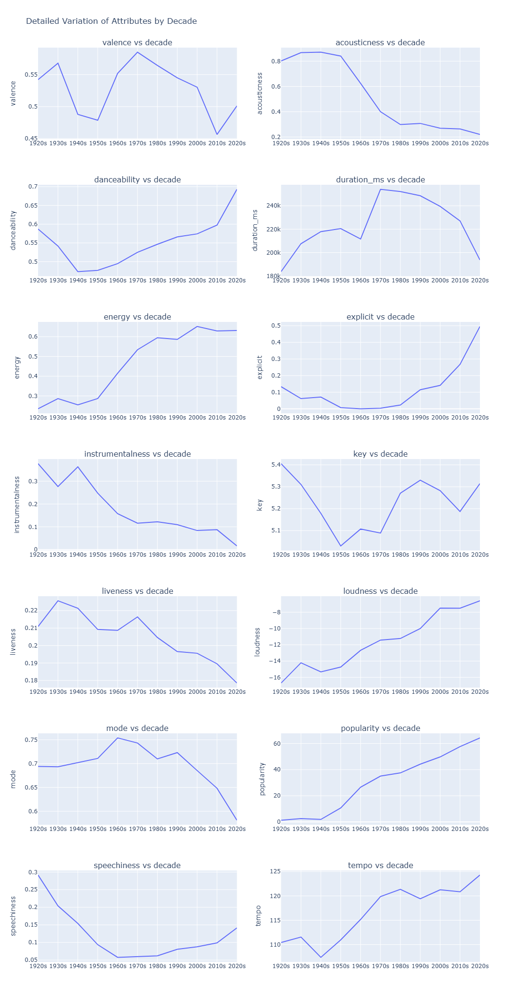

In [50]:
columns = [col for col in dataNum.columns if col != 'decade']

fig = make_subplots(rows=7, cols=2, subplot_titles=[f'{col} vs decade' for col in columns], vertical_spacing=0.05)

# Loop through the columns and add line plots to subplots
for i, colm in enumerate(columns):
    row = i // 2 + 1
    col = i % 2 + 1
    fig_col = px.line(dataNum, x=dataNum.index, y=dataNum[colm], title=f'{colm} vs decade')  # Assuming index is the x-axis
    for trace in fig_col.data:
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(title_text=colm, row=row, col=col)
fig.update_layout(
    title_text='Detailed Variation of Attributes by Decade',
    height=2100,  # Set total height based on number of rows
)
fig.show()

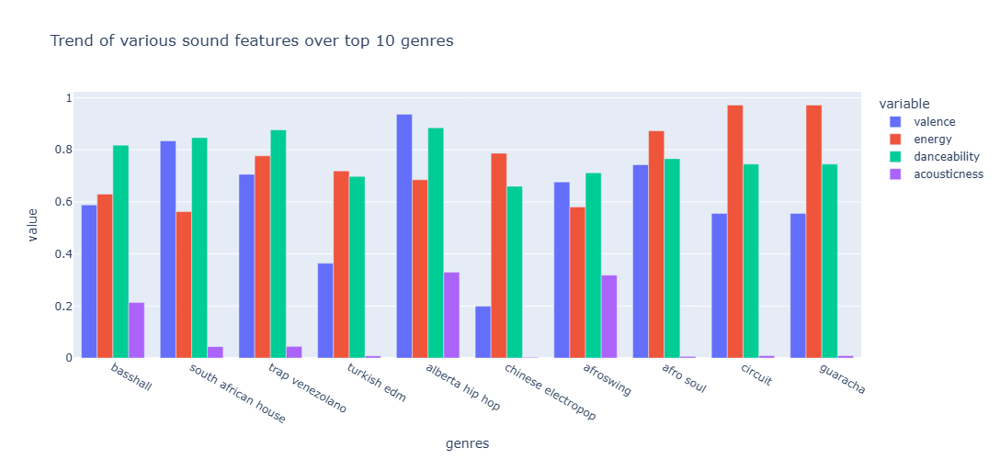

In [53]:
top10_genres = data_genres.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group',
            title='Trend of various sound features over top 10 genres')

fig.update_layout(
    height=500, 
)
fig.show()

In [97]:
X = data_genres.select_dtypes(np.number)
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=12))])
cluster_pipeline.fit(X)
data_genres['cluster'] = cluster_pipeline.predict(X)


In [79]:
data_genres['cluster'].value_counts()

cluster
6    790
2    490
5    458
0    443
3    386
1    383
4     23
Name: count, dtype: int64

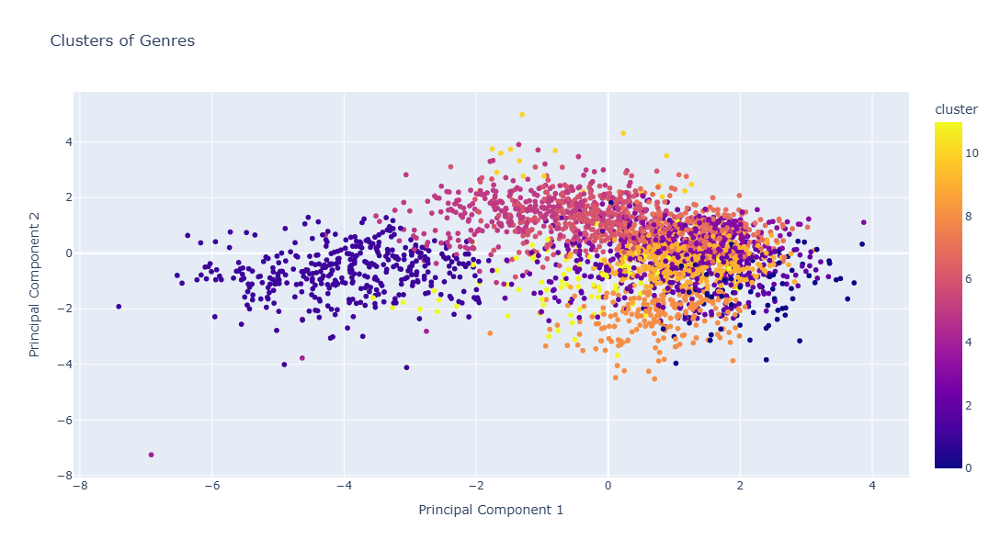

In [98]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
principal_components = pca_pipeline.fit_transform(X)  # X is your original data
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = data_genres['cluster']

fig = px.scatter(pca_df, x='PC1', y='PC2', color='cluster',
                 title='Clusters of Genres')

fig.update_layout(
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    height=600
    
)

fig.show()


In [100]:
X = data.select_dtypes(np.number)
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=25))])
cluster_pipeline.fit(X)
data['cluster'] = cluster_pipeline.predict(X)

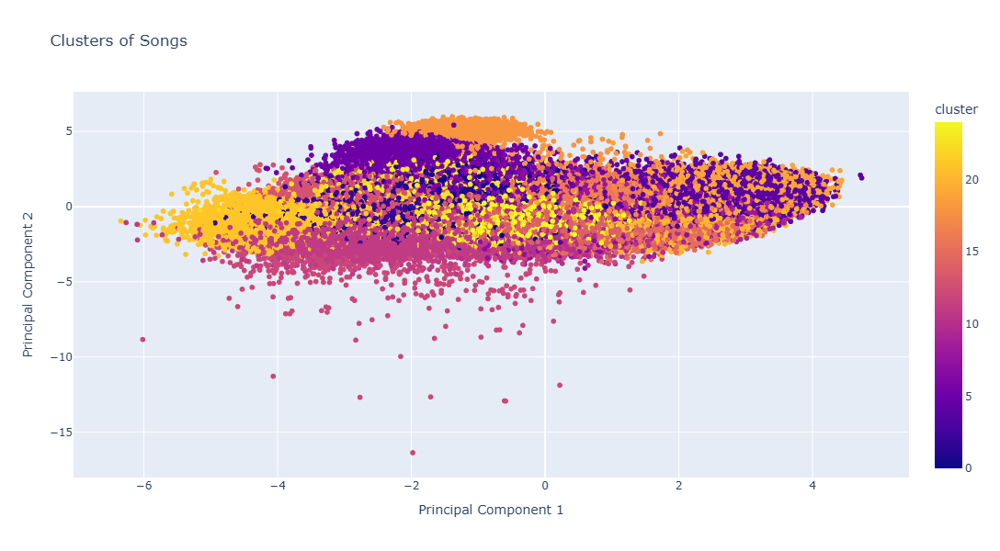

In [102]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
principal_components = pca_pipeline.fit_transform(X)  # X is your original data
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = data['cluster']

fig = px.scatter(pca_df, x='PC1', y='PC2', color='cluster',
                 title='Clusters of Songs')

fig.update_layout(
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    height=600
    
)

fig.show()


In [104]:
X = data_artist.select_dtypes(np.number)
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=20))])
cluster_pipeline.fit(X)
data_artist['cluster'] = cluster_pipeline.predict(X)

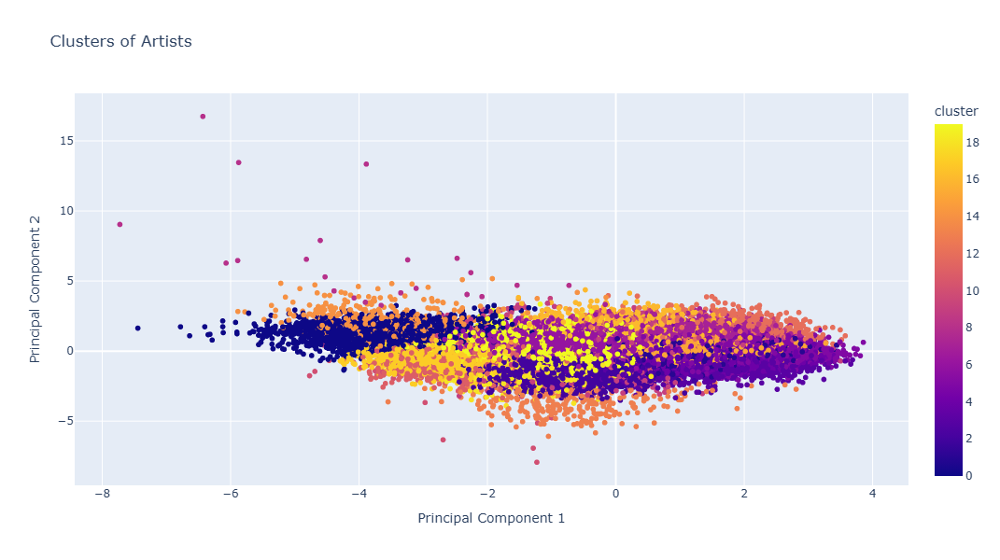

In [107]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
principal_components = pca_pipeline.fit_transform(X)  # X is your original data
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = data_artist['cluster']

fig = px.scatter(pca_df, x='PC1', y='PC2', color='cluster',
                 title='Clusters of Artists')

fig.update_layout(
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    height=600
    
)

fig.show()